In [1]:
import skrub
from pathlib import Path
import pandas as pd
import sys
import numpy as np 
import matplotlib.pyplot as plt

from sklearn.model_selection import cross_validate
from skrub import tabular_learner
from skrub import TableVectorizer

sys.path.append('/Users/alina/Desktop/MIT/code/ADHD/MTA/helper')
from helper import rr, prep, var_dict

%load_ext autoreload
%autoreload 2

In [2]:
if Path('/Volumes/Samsung_T5/MIT/mta').exists():
    data_root =     '/Volumes/Samsung_T5/MIT/mta'
    data_derived  = '/Volumes/Samsung_T5/MIT/mta/output/derived_data'
else: 
    data_root = '/Users/alina/Desktop/MIT/code/data'
    data_derived  = '/Users/alina/Desktop/MIT/code/data/output/derived_data'
#os.listdir(data_root)


In [3]:
'''
baseline_var = ['src_subject_id', 'interview_date', 'interview_age', 'sex', 'site', 'days_baseline']
dtypes_baseline = { 'src_subject_id' : 'str',
                    'interview_date': 'str' , 
                    'interview_age' : 'int64' ,
                    'sex' : 'str', 
                    'site' : 'int64' ,
                    'days_baseline':  'int64',
                    'version_form': 'str'}
version_form = ['version_form']
'''

"\nbaseline_var = ['src_subject_id', 'interview_date', 'interview_age', 'sex', 'site', 'days_baseline']\ndtypes_baseline = { 'src_subject_id' : 'str',\n                    'interview_date': 'str' , \n                    'interview_age' : 'int64' ,\n                    'sex' : 'str', \n                    'site' : 'int64' ,\n                    'days_baseline':  'int64',\n                    'version_form': 'str'}\nversion_form = ['version_form']\n"

In [4]:
snap_file = 'snap01.txt'

In [5]:
treat_group_file = 'treatment_groups.csv'
treat_group = pd.read_csv(Path(data_derived, treat_group_file))

In [6]:
snap = pd.read_csv(Path(data_root, snap_file), delimiter="\t", skiprows=[1])
snap_trt = prep.get_data(Path(data_root, snap_file), columns = None, treat_group= treat_group, set_dtypes= True, version_form= True, split_timepoints=False)

all columns
(14580, 160)
Success
(14580, 161)


### 1. drop NaN column and column that contain only contant values 

In [7]:
snap = snap_trt

In [8]:
snap = prep.set_baseline_dtypes(snap )
snap = snap.dropna(axis=1, how="all")
snap = snap.loc[:, snap.nunique(dropna=True) >1]
snap.dtypes

Success


snap01_id                  int64
subjectkey                object
src_subject_id            object
interview_date    datetime64[ns]
interview_age              int64
                       ...      
actbdic                    int64
site                    category
sjtyp                      int64
version_form              object
trtname                 category
Length: 72, dtype: object

remove columns with 
- Nan values (abover certain threshold ? e.g. more that 75% Nans)
- constant values 
- 999
- high association values with other column (redundant columns)

### Simplest pipeline

In [9]:
report = skrub.TableReport(snap)

In [122]:
report = skrub.TableReport(snap)
print(report._summary_without_plots.keys())
report_summary = report._summary_without_plots

top_assoss = report_summary['top_associations'] # extract top association, cravers V
# check how to change the metric used 
# high values here are t and x scores --> keep the T score 
# other high association : x score and 'snaxrsp' SNAP Adolescent Excellent Responder Score' --> this one contains the snahix I m trying to predict, so remove (not for prediction to other qsts)
np.array(top_assoss)

Processing column  72 / 72
dict_keys(['dataframe', 'dataframe_module', 'n_rows', 'n_columns', 'columns', 'first_row_dict', 'dataframe_is_empty', 'sample_table', 'n_constant_columns', 'top_associations'])


array([{'left_column_name': 'snaimpux', 'left_column_idx': 49, 'right_column_name': 'snaimput', 'right_column_idx': 50, 'cramer_v': 1.0},
       {'left_column_name': 'snaaddwx', 'left_column_idx': 51, 'right_column_name': 'snaaddwt', 'right_column_idx': 52, 'cramer_v': 1.0},
       {'left_column_name': 'sjtyp', 'left_column_idx': 69, 'right_column_name': 'trtname', 'right_column_idx': 71, 'cramer_v': 0.9999999999999999},
       {'left_column_name': 'snaoddx', 'left_column_idx': 53, 'right_column_name': 'snaoddt', 'right_column_idx': 54, 'cramer_v': 0.9996549613895025},
       {'left_column_name': 'relationship', 'left_column_idx': 66, 'right_column_name': 'version_form', 'right_column_idx': 70, 'cramer_v': 0.9908208280298769},
       {'left_column_name': 'snap01_id', 'left_column_idx': 0, 'right_column_name': 'version_form', 'right_column_idx': 70, 'cramer_v': 0.9835937214174097},
       {'left_column_name': 'snadbdx', 'left_column_idx': 62, 'right_column_name': 'snaxrsp', 'right_colum

In [131]:
for assos in top_assoss:
    print(assos['left_column_name'], assos['right_column_name'],' Cramer V: ',assos['cramer_v'])

snaimpux snaimput  Cramer V:  1.0
snaaddwx snaaddwt  Cramer V:  1.0
sjtyp trtname  Cramer V:  0.9999999999999999
snaoddx snaoddt  Cramer V:  0.9996549613895025
relationship version_form  Cramer V:  0.9908208280298769
snap01_id version_form  Cramer V:  0.9835937214174097
snadbdx snaxrsp  Cramer V:  0.9821129178957887
snatotlx snatotlt  Cramer V:  0.9735763173462725
snaadhdx snaadhdt  Cramer V:  0.9595293563299608
subjectkey src_subject_id  Cramer V:  0.9428096052231808
snahix snahit  Cramer V:  0.9217849322882364
snainatx snainatt  Cramer V:  0.9153206585710804
snahypax snahypat  Cramer V:  0.8940259808225803
snatotlt snaxrsp  Cramer V:  0.8728648284931978
snatotlx snaxrsp  Cramer V:  0.8728106004421736
snaadhdt snaxrsp  Cramer V:  0.8386615732444218
snaadhdx snaxrsp  Cramer V:  0.8372118865539759
snahit snaxrsp  Cramer V:  0.8290925683344615
snahix snaxrsp  Cramer V:  0.8284309037407149
snahypat snaxrsp  Cramer V:  0.8208405916034733


In [133]:
get_list = input()

In [139]:
split = get_list.split(',')
clean_list = [item.strip() for item in split ]
clean_list

['one', 'two', 'tree']

In [132]:
list('snapimpux', 'test', 'bb')

TypeError: list expected at most 1 argument, got 3

In [11]:
cols2rem = set()  # Using a set for automatic uniqueness

for dictt in top_assoss:
    left_col = dictt['left_column_name']
    right_col = dictt['right_column_name']
    
    if left_col.endswith('x') and right_col.endswith('t'):
        cols2rem.add(left_col)
    elif left_col.endswith('t') and right_col.endswith('x'):
        cols2rem.add(right_col)
    elif 'snaxrsp' in {left_col, right_col}:
        cols2rem.add('snaxrsp')

# Convert back to list if needed
cols2rem = list(cols2rem)

In [12]:
cols2rem

['snaimpux',
 'snaxrsp',
 'snaoddx',
 'snahix',
 'snainatx',
 'snaaddwx',
 'snahypax',
 'snaadhdx',
 'snatotlx']

In [13]:
#snap = snap.drop(columns=cols2rem)

In [14]:
target = "snahit"
data = snap.copy().dropna(subset=target) # should be no Nans in target column 

In [15]:
test_y = data.snahit
test_x = data.drop(columns = target)

In [16]:
model = tabular_learner("regressor") 
# combines TbaleVectorizer and 
# supervised leraner, default:  HistGradientBoostingRegressor
results = cross_validate(model, test_x, test_y)
scores = results["test_score"]


In [17]:
print(scores)
print(f"R2 score:  mean: {np.mean(scores):.3f}; std: {np.std(scores):.3f}")
print(f"mean fit time: {np.mean(results['fit_time']):.3f} seconds")

[0.99999857 0.99999974 0.99999178 0.99999871 0.99999962]
R2 score:  mean: 1.000; std: 0.000
mean fit time: 1.644 seconds


### Inspect resulst 

### Check out TableVectorizer

In [18]:
# this can be used to fine tune what kind fo transformations to use on what kind of variabels 
# when needed check again the tutorial https://skrub-data.org/stable/auto_examples/01_encodings.html

vectorizer = TableVectorizer()
#vect_snap = vectorizer.fit_transform(snap)
#vect_snap # vectorzed table 
#vectorizer.kind_to_columns_

### Specific regressor and feature importances

In [19]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.pipeline import make_pipeline
from sklearn.inspection import permutation_importance

In [20]:
test_x.columns

Index(['snap01_id', 'subjectkey', 'src_subject_id', 'interview_date',
       'interview_age', 'sex', 'snap_adhd_1', 'snap_adhd_2', 'snap_adhd_3',
       'snap_adhd_4', 'snap_adhd_5', 'snap_adhd_6', 'snap_adhd_7',
       'snap_adhd_8', 'snap_adhd_9', 'snap_adhd_11', 'snap_adhd_12',
       'snap_adhd_13', 'snap_adhd_14', 'snap_adhd_15', 'snap_adhd_16',
       'snap_adhd_17', 'snap_adhd_18', 'snap_adhd_19', 'sna19', 'sna20',
       'sna21', 'sna22', 'sna23', 'sna24', 'sna25', 'sna26', 'sna27', 'sna28',
       'sna29', 'sna30', 'sna31', 'sna32', 'sna33', 'sna34', 'sna35', 'sna36',
       'sna37', 'sna38', 'sna39', 'snainatx', 'snainatt', 'snahypax',
       'snahypat', 'snaimpux', 'snaimput', 'snaaddwx', 'snaaddwt', 'snaoddx',
       'snaoddt', 'snatotlx', 'snatotlt', 'snahyimx', 'snaadhdx', 'snaadhdt',
       'snahix', 'snadbdx', 'snaxrsp', 'days_baseline', 'assbdic',
       'relationship', 'actbdic', 'site', 'sjtyp', 'version_form', 'trtname'],
      dtype='object')

### drop subject ids bc they make roblems -- check again why 

In [21]:
#test_x = test_x.drop(columns= "subjectkey")#["src_subject_id",

#text_x = test_x.drop(columns="snahit") #this column hasthe higest feature importance score for predicting snahix 
#snap = snap.drop(columns="snahit") 
# not surprising becuase its the t score corresponding to the mean scoree snahix , so remove, see what happens


In [22]:
regressor = RandomForestRegressor()
vectorizer= TableVectorizer()
#vect_snap = vectorizer.fit_transform(snap)

In [23]:
pipeline = make_pipeline(vectorizer, regressor )

In [24]:
pipeline.fit(test_x, test_y)

Pipeline(steps=[('tablevectorizer', TableVectorizer()),
                ('randomforestregressor', RandomForestRegressor())])

In [25]:
avg_importances = regressor.feature_importances_ # this method suffers from bias, puting more imprtantce on features with high cardinalitzy
std_importances = np.std(
    [tree.feature_importances_ for tree in regressor.estimators_] , axis = 0)

In [26]:
indices = np.argsort(avg_importances)[::-1]
top_indices = indices[:10]
top_indices


array([121, 118,  77, 108, 117, 110, 109, 116,  93,  78])

In [27]:
vectorizer.get_feature_names_out()

array(['snap01_id',
       'subjectkey: ndar_invlp134yxx, ndar_invle813na3, ndar_invlz003nl7',
       'subjectkey: ndar_invga226jma, ndar_invge248ty0, ndar_invgf246agv',
       'subjectkey: ndar_invnw399gxl, ndar_invnt002gr6, ndar_invnl555pu9',
       'subjectkey: ndar_invxn851vy7, ndar_invxn409wjp, ndar_invzu852cf9',
       'subjectkey: ndar_invar880cw4, ndar_invaa588pvd, ndar_invzr812dn3',
       'subjectkey: ndar_invuc968epe, ndar_invuz768uv4, ndar_invuc212kr3',
       'subjectkey: ndar_invky650vfr, ndar_invky084meq, ndar_invky392fuv',
       'subjectkey: ndar_invjg184vrv, ndar_invjn402ugh, ndar_invjx946uw1',
       'subjectkey: ndar_invcz956fth, ndar_invcz954ygq, ndar_invzk895tp7',
       'subjectkey: ndar_invba367xlf, ndar_invbc816hkv, ndar_invbf509yf6',
       'subjectkey: ndar_invhf184tg1, ndar_invhh038ayl, ndar_invhj986ueg',
       'subjectkey: ndar_invvj578cmg, ndar_invvz127mhu, ndar_invvr979jtd',
       'subjectkey: ndar_invpt177gn4, ndar_invpt991taq, ndar_invpy548xgx',
     

In [28]:
labels = vectorizer.get_feature_names_out()[top_indices]

In [29]:
avg_importances[top_indices]

array([9.99951959e-01, 4.66364491e-05, 1.33725058e-07, 1.12184511e-07,
       8.66476217e-08, 8.55554838e-08, 7.66699204e-08, 7.12512894e-08,
       5.96689449e-08, 5.93235077e-08])

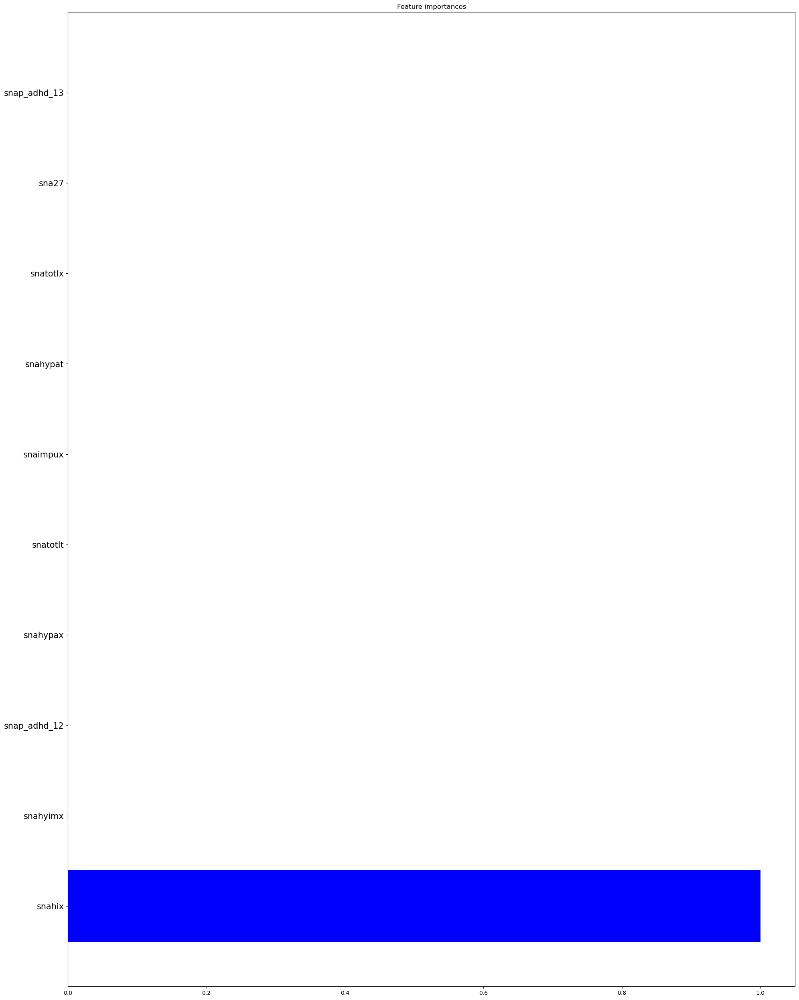

In [30]:
plt.figure(figsize=(20,25))

plt.barh(y = labels,
         width=  avg_importances[top_indices], 
         yerr = std_importances[top_indices],
         color = 'b'
         )
plt.yticks(fontsize=15)
plt.title("Feature importances")
plt.tight_layout(pad=1)
plt.show()

In [31]:
dir(vectorizer)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__sklearn_clone__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_build_request_for_signature',
 '_check_feature_names',
 '_check_n_features',
 '_check_specific_columns',
 '_doc_link_module',
 '_doc_link_template',
 '_doc_link_url_param_generator',
 '_encoders',
 '_get_default_requests',
 '_get_doc_link',
 '_get_metadata_request',
 '_get_param_names',
 '_get_tags',
 '_make_pipeline',
 '_more_tags',
 '_named_encoders',
 '_pipeline',
 '_postprocessors',
 '_preprocessors',
 '_repr_html_',
 '_repr_html_inner',
 '_repr_mimebundle_',
 '_sklearn_auto_wrap_output_keys',
 '_specific_columns',
 '_specific_transformers',
 '_store_column_kin

### Permuation importance -- check again at https://skrub-data.org/stable/auto_examples/03_datetime_encoder.html

In [32]:
# do not do that : proabaly use a seperate vectorized here 
# vect_x = vectorizer.fit_transform(test_x)
# vect_y = vectorizer.fit_transform(pd.DataFrame(test_y))

In [33]:
#
#perm_importance_dict = permutation_importance(regressor,vect_x, vect_y)

In [34]:
# perm_importance_dict
# avg_perm_import = perm_importance_dict['importances_mean']
# std_perm_import = perm_importance_dict['importances_std']

In [35]:
# perm_indices = np.argsort(avg_perm_import)[::-1]
# top_indices_perm = perm_indices[:5]
# top_indices_perm 

In [36]:
# plt.figure(figsize=(10,15))

# plt.barh(y = labels,
#          width=  avg_perm_import[top_indices_perm], 
#          yerr = std_perm_import[top_indices_perm],
#          color = 'b'
#          )
# plt.yticks(fontsize=15)
# plt.title("Feature importances")
# plt.tight_layout(pad=1)
# plt.show()

### Join with another table 

In [37]:
# join SNAP and CBCL 

In [38]:
cbcl_file = 'cbcl01.txt'
cbcl = pd.read_csv(Path(data_root, cbcl_file), delimiter='\t', skiprows=[1])

In [39]:
snap

,snap01_id,subjectkey,src_subject_id,interview_date,interview_age,sex,snap_adhd_1,snap_adhd_2,snap_adhd_3,snap_adhd_4,...,snadbdx,snaxrsp,days_baseline,assbdic,relationship,actbdic,site,sjtyp,version_form,trtname
0,19789,NDAR_INVXP413AM1,P1001,1997-06-28,156,M,0.0,0.0,1.0,0.0,...,0.12,1.0,0,LB,1,0,1,2,Parent,L
1,19790,NDAR_INVXP413AM1,P1001,1997-06-28,156,M,0.0,0.0,1.0,0.0,...,0.12,1.0,0,LB,2,0,1,2,Parent,L
2,19791,NDAR_INVXP413AM1,P1001,1998-10-02,171,M,0.0,0.0,0.0,0.0,...,0.00,1.0,461,36,2,0,1,2,Parent,L
3,19792,NDAR_INVXP413AM1,P1001,1998-10-23,172,M,0.0,0.0,0.0,0.0,...,0.04,1.0,482,36,1,0,1,2,Parent,L
4,19793,NDAR_INVXP413AM1,P1001,2001-11-26,210,M,0.0,0.0,0.0,0.0,...,0.00,1.0,1612,72,1,0,1,2,Parent,L
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14575,34364,NDAR_INVPE614HET,P1868,2002-11-18,154,F,1.0,0.0,0.0,0.0,...,0.08,1.0,1753,72,14,0,1,2,Teacher,L
14576,34365,NDAR_INVPE614HET,P1868,2002-11-18,154,F,1.0,0.0,0.0,0.0,...,0.23,1.0,1753,72,14,0,1,2,Teacher,L
14577,34366,NDAR_INVPE614HET,P1868,2004-10-25,178,F,0.0,0.0,0.0,0.0,...,0.19,1.0,2460,96,14,0,1,2,Teacher,L
14578,34367,NDAR_INVPE614HET,P1868,2004-11-02,178,F,1.0,2.0,1.0,1.0,...,0.96,1.0,2468,96,14,0,1,2,Teacher,L


In [40]:
# missing values cbcl Very true; 999=NA; 77=Refused; 88=Missing

In [41]:
cbcl.relationship.unique()

array([ 1,  2, 21, 22, 24, 26, 23, 25, 19, 20, 50])

In [ ]:
missing_vals = [999, -999, 88, 77, 98, 99, 9]
missing_val_codes_cbcl = missing_vals.copy()
for val in missing_vals:
    missing_val_codes_cbcl.append(str(val))


In [43]:
missing_val_codes_cbcl

[999, -999, 88, 77, 98, 99, 9, '999', '-999', '88', '77', '98', '99', '9']

In [44]:
def find_columns_to_remove(df, cols_to_add=None):
    """
    Identify columns to remove based on specific naming conventions across all columns in a DataFrame.
    
    Parameters:
    - df: DataFrame with columns to be checked
    
    Returns:
    - List of column names to remove
    """
    cols2rem = set()
    column_names = list(df.columns)
    
    # Pre-filter columns based on suffixes to reduce comparisons
    x_columns = [col for col in column_names if col.endswith('x')]
    t_columns = [col for col in column_names if col.endswith('t')]
    raw_columns = [col for col in column_names if col.endswith('raw')]
    snaxrsp_columns = [col for col in column_names if 'snaxrsp' in col]
    
    # Check x and t suffix criteria - only add 'x' if paired with the same base name 't'
    for x_col in x_columns:
        base_name_x = x_col[:-2]  # Remove '_x' suffix
        for t_col in t_columns:
            base_name_t = t_col[:-2]  # Remove '_t' suffix
            if base_name_x == base_name_t:
                cols2rem.add(x_col)
                break  # No need to check further once we find a matching 't'

    # Check raw criteria - add 'raw' columns and their base columns if base exists
    for raw_col in raw_columns:
        base_name = raw_col[:-4]
        if base_name in column_names:
            cols2rem.add(raw_col)
            #cols2rem.add(base_name)
    
    # Check snaxrsp criteria - add columns with 'snaxrsp' in the name
    if cols_to_add is not None: 
        cols2rem.update(cols_to_add)
    
    return list(cols2rem)


In [45]:
find_columns_to_remove(cbcl)

['cbcl_sct_raw',
 'cbcl_rulebreak_raw',
 'cbcl_aggressive_raw',
 'cbcl_total_raw',
 'cbcl_conduct_raw',
 'cbcl_external_raw',
 'cbcl_pervasive_raw',
 'cbcl_affective_raw',
 'cbcl_oppositional_raw',
 'cbcl_ocd_raw',
 'cbcl_anxiety_raw',
 'cbcl_depresspr_raw',
 'cbcl_sleep_raw',
 'cb7dlqx',
 'cbcl_thought_raw',
 'cbcl_total_c_raw',
 'cbcl_emotional_raw',
 'cbcl_anxious_raw',
 'cbcl_somatic_p_raw',
 'cbcl_ptsd_raw',
 'cbcl_activities_raw',
 'cbcl_attention_raw',
 'cbcl_social_c_raw',
 'cb9sexx',
 'cbcl_school_raw',
 'cbcl_withdrawn_raw',
 'cbcl_social_p_raw',
 'cbcl_internal_raw',
 'cbcl_somatic_c_raw',
 'cbcl_adhd_raw']

In [119]:
cbcl.relationship.unique()

array([ 1,  2, 21, 22, 24, 26, 23, 25, 19, 20, 50])

In [46]:
### add a way to select specifi columns where to conversion to NaN does not hapen (e.g. in snap , relationship has value 88 for professional, but elsewhere it is a missing value)
def pre_audit(df, missing_val_codes, cols_known_to_remove = None):
    df_clean= df.copy()
    cols2rem = find_columns_to_remove(df, cols_known_to_remove)
    df_clean = df.drop(columns = cols2rem)
    
    df_clean = prep.set_baseline_dtypes(df_clean) # set dtypes for baseline vars, e.g. site, src_subject id, time
    df_clean = df_clean.replace(missing_val_codes, np.nan) #replace all values that represent missing values with nan

    df_clean  = df_clean.dropna(axis=1, how="all") # drop empty columns 
    df_clean = df_clean.loc[:, df_clean.nunique(dropna=True) >1] # drop columns that contain only one constant value 
    print('Old shape: ', df.shape)
    print('New shape: ', df_clean.shape)
    print('dtypes: ')
    print(df_clean.dtypes)
    return df_clean

In [47]:
def get_top_assossiations(df):
    report = skrub.TableReport(df)
    print(report._summary_without_plots.keys())
    report_summary = report._summary_without_plots

    top_assoss = report_summary['top_associations'] # extract top association, cravers V
    # check how to change the metric used 
    # high values here are t and x scores --> keep the T score 
    # other high association : x score and 'snaxrsp' SNAP Adolescent Excellent Responder Score' --> this one contains the snahix I m trying to predict, so remove (not for prediction to other qsts)
    return np.array(top_assoss)

In [48]:
cbcl_clean = pre_audit(cbcl, missing_val_codes_cbcl)

Success
Old shape:  (4063, 489)
New shape:  (4063, 180)
dtypes: 
cbcl01_id                  int64
subjectkey                object
src_subject_id            object
interview_date    datetime64[ns]
interview_age            float64
                       ...      
days_baseline              int64
assbdic                   object
actbdic                    int64
site                    category
sjtyp                      int64
Length: 180, dtype: object


### Watch out for : 
- assessment point var : assbdic
- actbdic : active status (0=Inactive-Data collected after the 14 month treatment phase/after early termination from treatment phase/prior to treatment phase; 1=Active-Data collected during the 14 month treatment phase while subject received originally assigned treatment regardless of degree of compliance; 2=Active-This is the last active assessment for subjects who were about to violate treatment arm by receiving alternate treatment; 3=Active-This is the last active assessment for subjects who were about to leave the study by moving away;4=Yes, Active; 5=No, Not Active)

### Check
- sjtype =MTA randomized trial subject; 2=Local normative comparison group (LNCG) subject
- should be correlated exactly with trtnames 

### Questions 
- what to do with summary questiosn (allways highly correlated with questions they summarize)

In [49]:
# assessment point var : assbdic

In [50]:
skrub.TableReport(cbcl_clean)

Processing column 180 / 180


<TableReport: use .open() to display>

In [51]:
cbcl_top_assoc = get_top_assossiations(cbcl_clean)
# for cbcl : raw score in var_name_raw and t score in var_name

Processing column 180 / 180
dict_keys(['dataframe', 'dataframe_module', 'n_rows', 'n_columns', 'columns', 'first_row_dict', 'dataframe_is_empty', 'sample_table', 'n_constant_columns', 'top_associations'])


In [52]:
cbcl_top_assoc

array([{'left_column_name': 'subjectkey', 'left_column_idx': 1, 'right_column_name': 'src_subject_id', 'right_column_idx': 2, 'cramer_v': 0.8165011586110625},
       {'left_column_name': 'assbdic', 'left_column_idx': 176, 'right_column_name': 'sjtyp', 'right_column_idx': 179, 'cramer_v': 0.786008520902933},
       {'left_column_name': 'cbcl9', 'left_column_idx': 48, 'right_column_name': 'cbcl_thought', 'right_column_idx': 170, 'cramer_v': 0.7773899154161614},
       {'left_column_name': 'cbcl59', 'left_column_idx': 105, 'right_column_name': 'cb9sext', 'right_column_idx': 174, 'cramer_v': 0.7704582668633339},
       {'left_column_name': 'cbcl101', 'left_column_idx': 147, 'right_column_name': 'cbcl_thought', 'right_column_idx': 170, 'cramer_v': 0.7652541220743769},
       {'left_column_name': 'cbcl20', 'left_column_idx': 59, 'right_column_name': 'cbcl21', 'right_column_idx': 60, 'cramer_v': 0.7645283947809292},
       {'left_column_name': 'cbcl70', 'left_column_idx': 116, 'right_column_n

### Check if need to remove columns with high associationsusing some other criteria 

In [53]:
cols2rem = set()  # Using a set for automatic uniqueness

for dictt in cbcl_top_assoc:
    left_col = dictt['left_column_name']
    right_col = dictt['right_column_name']

    
    if left_col.endswith('x') and right_col.endswith('t'):
        cols2rem.add(left_col)
    elif left_col.endswith('t') and right_col.endswith('x'):
        cols2rem.add(right_col)
    elif 'snaxrsp' in {left_col, right_col}:
        cols2rem.add('snaxrsp')
    elif left_col.endswith('raw') and right_col == left_col[:-4]:
        cols2rem.add(left_col)
    if right_col.endswith('raw') and left_col == right_col[:-4]:
        cols2rem.add(right_col)

# Convert back to list if needed
cols2rem = list(cols2rem)

In [54]:
cols2rem

[]

In [55]:
cbcl_clean_ = cbcl_clean.drop(columns=cols2rem)

In [56]:
cbcl_clean_.shape

(4063, 180)

In [57]:
skrub.TableReport(cbcl_clean_)

Processing column 180 / 180


<TableReport: use .open() to display>

In [58]:
skrub.TableReport(snap)

Processing column  72 / 72


<TableReport: use .open() to display>

In [59]:
missing_vals_snap = [-999, 88, 77, -99, 999 ]
cols_known_to_remove_snap = ['snaxrsp']
# 88  is also a value for a specific rater in the column relationship : 88 = Professional (e.g., social worker, nurse, therapist, psychiatrist, or group home staff);

In [60]:
find_columns_to_remove(snap)

['snaimpux',
 'snaoddx',
 'snahix',
 'snainatx',
 'snaaddwx',
 'snahypax',
 'snaadhdx',
 'snatotlx']

In [61]:
snap_clean = pre_audit(snap, missing_vals_snap, cols_known_to_remove_snap)

Success
Old shape:  (14580, 72)
New shape:  (14580, 63)
dtypes: 
snap01_id                  int64
subjectkey                object
src_subject_id            object
interview_date    datetime64[ns]
interview_age            float64
                       ...      
actbdic                    int64
site                    category
sjtyp                      int64
version_form              object
trtname                 category
Length: 63, dtype: object


In [121]:
snap.snap01_id.unique()

array([19789, 19790, 19791, ..., 34366, 34367, 34368])

In [62]:
skrub.TableReport(snap_clean)

Processing column  63 / 63


<TableReport: use .open() to display>

### Extract times
using timepoints for now but in the end use the variable assessment (look above for var name)

In [63]:
snap_clean

,snap01_id,subjectkey,src_subject_id,interview_date,interview_age,sex,snap_adhd_1,snap_adhd_2,snap_adhd_3,snap_adhd_4,...,snahit,snadbdx,days_baseline,assbdic,relationship,actbdic,site,sjtyp,version_form,trtname
0,19789,NDAR_INVXP413AM1,P1001,1997-06-28,156.0,M,0.0,0.0,1.0,0.0,...,2.0,0.12,0.0,LB,1,0,1,2,Parent,L
1,19790,NDAR_INVXP413AM1,P1001,1997-06-28,156.0,M,0.0,0.0,1.0,0.0,...,0.0,0.12,0.0,LB,2,0,1,2,Parent,L
2,19791,NDAR_INVXP413AM1,P1001,1998-10-02,171.0,M,0.0,0.0,0.0,0.0,...,0.0,0.00,461.0,36,2,0,1,2,Parent,L
3,19792,NDAR_INVXP413AM1,P1001,1998-10-23,172.0,M,0.0,0.0,0.0,0.0,...,0.0,0.04,482.0,36,1,0,1,2,Parent,L
4,19793,NDAR_INVXP413AM1,P1001,2001-11-26,210.0,M,0.0,0.0,0.0,0.0,...,0.0,0.00,1612.0,72,1,0,1,2,Parent,L
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14575,34364,NDAR_INVPE614HET,P1868,2002-11-18,154.0,F,1.0,0.0,0.0,0.0,...,0.0,0.08,1753.0,72,14,0,1,2,Teacher,L
14576,34365,NDAR_INVPE614HET,P1868,2002-11-18,154.0,F,1.0,0.0,0.0,0.0,...,3.0,0.23,1753.0,72,14,0,1,2,Teacher,L
14577,34366,NDAR_INVPE614HET,P1868,2004-10-25,178.0,F,0.0,0.0,0.0,0.0,...,3.0,0.19,2460.0,96,14,0,1,2,Teacher,L
14578,34367,NDAR_INVPE614HET,P1868,2004-11-02,178.0,F,1.0,2.0,1.0,1.0,...,12.0,0.96,2468.0,96,14,0,1,2,Teacher,L


In [64]:
timepoints = [46,168,319,500]

In [65]:
cbcl_clean_split = prep.split_data_from_timepoints(cbcl_clean, timepoints)
snap_clean_split = prep.split_data_from_timepoints(snap_clean, timepoints)

/Users/alina/Desktop/MIT/code/ADHD/MTA/helper/prep.py:100: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['days_baseline'] = df['days_baseline'].astype(int)


In [66]:
cbcl_clean_split

{46:       cbcl01_id        subjectkey src_subject_id interview_date  \
 0          2158  NDAR_INVXP413AM1          P1001     1997-06-27   
 1          2159  NDAR_INVXP413AM1          P1001     1997-06-27   
 4          2162  NDAR_INVFC713CVK          P1002     1997-06-02   
 5          2163  NDAR_INVFC713CVK          P1002     1997-06-02   
 10         2168  NDAR_INVFE961JZZ          P1003     1995-06-26   
 ...         ...               ...            ...            ...   
 4054       6212  NDAR_INVGB054KLF          P1866     1998-07-16   
 4057       6215  NDAR_INVJW789CKY          P1867     1998-01-28   
 4058       6216  NDAR_INVJW789CKY          P1867     1998-01-28   
 4060       6218  NDAR_INVPE614HET          P1868     1998-01-30   
 4061       6219  NDAR_INVPE614HET          P1868     1998-01-30   
 
       interview_age sex  sports_time1  sports_well1  sports_time2  \
 0             156.0   M           2.0           2.0           2.0   
 1             156.0   M           2.0

In [67]:
for cbcll, snapp in zip(cbcl_clean_split.values(), snap_clean_split.values()):
    print(cbcll.shape, snapp.shape)
    print(cbcll.src_subject_id.unique().shape,snap.src_subject_id.unique().shape)
    print((cbcll.src_subject_id.value_counts() > 1).sum(), (snapp.src_subject_id.value_counts() > 1).sum())

(1370, 180) (3363, 63)
(856,) (868,)
509 852
(1384, 180) (4299, 63)
(856,) (868,)
511 852
(1498, 180) (5731, 63)
(856,) (868,)
550 855
(2483, 180) (7429, 63)
(864,) (868,)
787 859


In [68]:
cbcl.version_form.dropna()

Series([], Name: version_form, dtype: float64)

In [69]:
duplicates = cbcl_clean_split[46].loc[
    cbcl_clean_split[46]['src_subject_id'].isin(
        cbcl_clean_split[46]['src_subject_id'].value_counts()[cbcl_clean_split[46]['src_subject_id'].value_counts() > 1].index
    ), 
    ['src_subject_id', 'relationship']
]

print(duplicates['relationship'].unique())


[ 1  2 21 24 23 25 22 50 19 20]


1 = Biological mom; 2 = Biological dad; 3 = Grandparent;   6 = Occupational therapist; 7 = Speech and language therapist; 8 = Behavioral therapist; 9 = Paraprofessional; 10 = Aide; 11 = Principal; 12 = Administrator; 15 = Parent center director; 16 = Self; 17 = Adoptive mother; 18 = Adoptive father; 19 = Foster mother; 20 = Foster father; 21 = Grandmother; 22 = Grandfather; 23 = Step-mother; 24 = Step-father; 25 = Aunt; 26 = Uncle; 28 = Both parents; 31 = Grandmother from mother side; 32 = Grandfather from mother side; 33 = Grandmother from father side; 34 = Grandfather from father side; 36 = Brother; 37 = Sister; 38 = Cousin; 39 = Female caregiver; 40 = Male caregiver; 41 = Female child; 42 = Male child; 43 = Spouse/Mate; 44 = Friend; 45 = Parent; 46 = Significant other; 47 = Sibling; 48 = Son/Daughter; 49 = Son-in-law/Daughter-in law; 50 = Other Relative; 51 = Paid caregiver; 52 = Friends; 53 = Roommate; 55 = Mother's boyfriend; 56 = Other parental figure; 57 = Summary; 58 = Counselor; 59 = Other female relative; 60 = Other male relative; 61 = Non-relative ; 62 = Maternal Aunt; 63 = Maternal Uncle; 64 = Maternal Cousin; 65 = Paternal Aunt; 66 = Paternal Uncle; 67 = Paternal Cousin; 68 = Biological/Adoptive Mother and Grandmother; 69 = Biological/Adoptive Mother and Stepmother and Grandmother; 70 = Biological/Adoptive Mother and Grandmother and Foster Father; 71 = Biological/Adoptive Mother and Stepmother and Foster Mother; 72 = Biological/Adoptive Mother and Foster Mother; 73 = Biological/Adoptive Mother and Biological/Adoptive Father; 74 = Biological/Adoptive Mother and Stepmother and Biological/Adoptive Father; 75 = Biological/Adoptive Mother and Other; 76 = Biological/Adoptive Mother and Stepmother and Stepfather; 77 = Biological/Adoptive Mother and Stepfather; 78 = Biological/Adoptive Mother and Grandfather; 79 = Biological/Adoptive Mother and Stepmother and Foster Father; 80 = Biological/Adoptive Mother and Stepmother; 81 = Guardian, female; 82 = Other female; 83 = Guardian, male; 84 = Other male; 85 = Other/Grandparent/Nanny; 86 = Mother, Father, Guardian; 87 = Daughter, son, grandchild; 88 = Professional (e.g., social worker, nurse, therapist, psychiatrist, or group home staff); -999 = Missing; 89 = Biological parent; 90 = Other; 91 = Stepparent; 92 = Adoptive parent; 93 = Foster parent; 94 = Co-worker; 95 = Independent Evaluator

4 = Special education (sped) teacher;
5 = General education teacher;
 14 = Content teacher;
 54 = Supervisor; 

### CBCL all parent form

In [70]:
cbcl['relationship'].value_counts()

relationship
1     2449
2     1266
24     146
21      73
22      40
23      33
25      23
19      15
50       8
20       6
26       4
Name: count, dtype: int64

In [71]:
snap.relationship.value_counts()

relationship
1     5179
14    2849
5     2694
2     2336
13     815
24     266
21     158
22      77
23      60
25      48
4       47
19      31
20      13
26       7
Name: count, dtype: int64

In [72]:
snap[snap['version_form'] == 'Teacher'].relationship.value_counts()

relationship
14    2849
5     2694
13     788
4       47
Name: count, dtype: int64

### for now select only one of the relatiosnhip to test out joining, but then figure out which one to use based on a rational

In [73]:
cbcl_base = cbcl_clean_split[46][cbcl_clean_split[46]['relationship'] == 1]
snap_base = snap_clean_split[46][snap_clean_split[46]['version_form'] == 'Parent']

### Join CBCL and SNAP

In [74]:
duplicates = cbcl_base.loc[
    cbcl_base['src_subject_id'].isin(
        cbcl_base['src_subject_id'].value_counts()[cbcl_base['src_subject_id'].value_counts() > 1].index
    ), 
    ['src_subject_id', 'relationship']
]

print(duplicates)

Empty DataFrame
Columns: [src_subject_id, relationship]
Index: []


In [75]:
duplicates = snap_base.loc[
    snap_base['src_subject_id'].isin(
        snap_base['src_subject_id'].value_counts()[snap_base['src_subject_id'].value_counts() > 1].index
    ), 
    ['src_subject_id', 'version_form']
]

print(duplicates.shape)

(1790, 2)


In [76]:
snap_base= snap_clean_split[46].drop_duplicates(subset='src_subject_id', keep='first')


In [77]:
augmented_df = skrub.fuzzy_join(
    snap_base,  # our table to join
    cbcl_base,  # the table to join with
    left_on="src_subject_id",  # the first join key column
    right_on="src_subject_id" , # the second join key column
    add_match_info=True,
    drop_unmatched=False
)

augmented_df.tail(20)

,snap01_id,subjectkey,src_subject_id,interview_date,interview_age,sex,snap_adhd_1,snap_adhd_2,snap_adhd_3,snap_adhd_4,...,cb7dlqt,cb9sext,days_baseline__skrub_824ed564__,assbdic__skrub_06ecd30d__,actbdic__skrub_e352761a__,site__skrub_e0020ec1__,sjtyp__skrub_f6b0a6a2__,skrub_Joiner_distance,skrub_Joiner_rescaled_distance,skrub_Joiner_match_accepted
848,27878,NDAR_INVDU262ALH,P1853,1998-02-09,96.0,F,1.0,1.0,1.0,0.0,...,NaN,NaN,0,LB,0,1,2,0.000000,0.000000,True
849,27883,NDAR_INVJE493VKT,P1854,1998-03-03,96.0,M,0.0,1.0,1.0,1.0,...,NaN,NaN,0,LB,0,2,2,0.000000,0.000000,True
850,27889,NDAR_INVXL971BGM,P1855,1998-01-10,96.0,M,1.0,0.0,0.0,0.0,...,NaN,NaN,0,LB,0,3,2,0.000000,0.000000,True
851,27894,NDAR_INVUT441DJ6,P1856,1998-05-13,96.0,F,2.0,1.0,2.0,1.0,...,NaN,NaN,0,LB,0,4,2,0.000000,0.000000,True
852,27902,NDAR_INVYA810GCM,P1857,1998-02-23,96.0,F,1.0,1.0,1.0,1.0,...,NaN,NaN,0,LB,0,1,2,0.000000,0.000000,True
853,27909,NDAR_INVNF768PZG,P1858,1998-04-04,96.0,M,0.0,0.0,0.0,0.0,...,NaN,NaN,0,LB,0,4,2,0.000000,0.000000,True
854,27913,NDAR_INVLH697YXW,P1859,1998-05-28,96.0,M,0.0,0.0,0.0,0.0,...,NaN,NaN,0,LB,0,6,2,0.000000,0.000000,True
855,27921,NDAR_INVGP394HMX,P1860,1998-01-02,96.0,M,0.0,0.0,1.0,1.0,...,NaN,NaN,0,LB,0,2,2,0.000000,0.000000,True
856,27930,NDAR_INVXL291KV7,P1861,1998-03-09,96.0,F,2.0,1.0,1.0,1.0,...,NaN,NaN,0,LB,0,4,2,1.139962,0.821846,True
857,27935,NDAR_INVWH779PHC,P1862,1998-03-18,96.0,M,1.0,0.0,1.0,0.0,...,NaN,NaN,0,LB,0,1,2,0.000000,0.000000,True


In [78]:
augmented_df.shape

(868, 246)

In [79]:
augmented_df.columns

Index(['snap01_id', 'subjectkey', 'src_subject_id', 'interview_date',
       'interview_age', 'sex', 'snap_adhd_1', 'snap_adhd_2', 'snap_adhd_3',
       'snap_adhd_4',
       ...
       'cb7dlqt', 'cb9sext', 'days_baseline__skrub_824ed564__',
       'assbdic__skrub_06ecd30d__', 'actbdic__skrub_e352761a__',
       'site__skrub_e0020ec1__', 'sjtyp__skrub_f6b0a6a2__',
       'skrub_Joiner_distance', 'skrub_Joiner_rescaled_distance',
       'skrub_Joiner_match_accepted'],
      dtype='object', length=246)

D=MTA baseline assessment; 14=MTA 14 month assessment; E=MTA early termination assessment; B = MTA Pre-Baseline Screening Assessment (579/579); 09 = MTA 9 Month Assessment (530/530); 24=MTA 24 month assessment; LB=LNCG baseline assessment; 36=MTA and LNCG 3 year assessment; 72=MTA and LNCG 6 year assessment; 96=MTA and LNCG 8 year assessment; 03 = MTA 3 Month Assessment (438/687);120=MTA and LNCG 10 year assessment; 7= 7th Grade Assessment (221/276); 144 = MTA & LNCG 12 Month Assessment (578/578); 168 = MTA & LNCG 14 Month Assessment (585/585); 192 = MTA & LNCG 16 Month Assessment (505/505); C = MTA Pre-Baseline Screening Assessment (78/78)

In [80]:
cbcl.assbdic.unique()

array(['LB', '36', 'D', '14', '24', 'E'], dtype=object)

In [81]:
cbcl_b = cbcl_clean[cbcl_clean['assbdic'] == 'D']
cbcl_b.src_subject_id.value_counts().value_counts()

count
2    351
1    215
3      2
4      1
Name: count, dtype: int64

In [82]:
snap.assbdic.value_counts()

assbdic
36     2245
72     1916
96     1608
D      1464
9      1313
14     1307
24     1307
B      1155
3       911
LB      746
120     564
E        37
144       7
Name: count, dtype: int64

In [83]:
snap_b = snap_clean[snap_clean['assbdic'] == 'D']

In [84]:
snap_b[snap_b.version_form == 'Teacher'].src_subject_id.value_counts().value_counts()

count
1    544
2      1
Name: count, dtype: int64

In [85]:
cbcl_b[cbcl_b.src_subject_id == 'P1002'].relationship

4    1
5    2
Name: relationship, dtype: int64

In [86]:
print('relationship' in snap.columns)
print('relationship' in snap_b.columns)

True
True


In [87]:
snap_b[snap_b.src_subject_id == 'P1002'].relationship

7       1
8       2
8209    5
Name: relationship, dtype: int64

In [88]:
skrub.fuzzy_join(cbcl_b, snap_b,on='src_subject_id')

,cbcl01_id,subjectkey,src_subject_id,interview_date,interview_age,sex,sports_time1,sports_well1,sports_time2,sports_well2,...,snahit,snadbdx,days_baseline__skrub_1410b5ac__,assbdic__skrub_91dddb5e__,relationship__skrub_f07d5ae4__,actbdic__skrub_ff23a4b0__,site__skrub_edfff8c5__,sjtyp__skrub_85366215__,version_form,trtname
0,2162,NDAR_INVFC713CVK,P1002,1997-06-02,120.0,M,1.0,1.0,1.0,2.0,...,7.00,1.00,0.0,D,1,1,1,1,Parent,C
1,2163,NDAR_INVFC713CVK,P1002,1997-06-02,120.0,M,1.0,1.0,2.0,1.0,...,7.00,1.00,0.0,D,1,1,1,1,Parent,C
2,2168,NDAR_INVFE961JZZ,P1003,1995-06-26,108.0,M,1.0,1.0,2.0,1.0,...,24.75,2.63,0.0,D,1,1,2,1,Parent,M
3,2169,NDAR_INVFE961JZZ,P1003,1995-06-26,108.0,M,2.0,1.0,1.0,1.0,...,24.75,2.63,0.0,D,1,1,2,1,Parent,M
4,2176,NDAR_INVLE183KCP,P1004,1995-04-02,108.0,F,1.0,1.0,NaN,NaN,...,19.00,1.77,0.0,D,1,1,2,1,Parent,M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
922,6116,NDAR_INVPD521YYV,P1839,1995-02-13,72.0,M,1.0,3.0,1.0,2.0,...,16.00,1.58,0.0,D,1,1,4,1,Parent,C
923,6117,NDAR_INVPD521YYV,P1839,1995-02-13,72.0,M,0.0,2.0,0.0,1.0,...,16.00,1.58,0.0,D,1,1,4,1,Parent,C
924,6130,NDAR_INVHK435ZRN,P1842,1995-02-21,72.0,M,2.0,2.0,1.0,2.0,...,19.00,1.88,0.0,D,1,1,4,1,Parent,M
925,6137,NDAR_INVXP709VPA,P1844,1995-04-23,72.0,M,0.0,1.0,2.0,2.0,...,25.00,2.35,0.0,D,1,1,4,1,Parent,A


### DO hierarchical clustering separate for parent ad teacher rations for now 
Ask satra wbout long or wide format to combine questionnaires

In [89]:
cbcl_b

,cbcl01_id,subjectkey,src_subject_id,interview_date,interview_age,sex,sports_time1,sports_well1,sports_time2,sports_well2,...,cbcl_thought,cbcl_somatic_p,relationship,cb7dlqt,cb9sext,days_baseline,assbdic,actbdic,site,sjtyp
4,2162,NDAR_INVFC713CVK,P1002,1997-06-02,120.0,M,1.0,1.0,1.0,2.0,...,0.0,1.0,1,2.0,0.0,0,D,1,1,1
5,2163,NDAR_INVFC713CVK,P1002,1997-06-02,120.0,M,1.0,1.0,2.0,1.0,...,0.0,1.0,2,1.0,0.0,0,D,1,1,1
10,2168,NDAR_INVFE961JZZ,P1003,1995-06-26,108.0,M,1.0,1.0,2.0,1.0,...,3.0,0.0,1,4.0,0.0,0,D,1,2,1
11,2169,NDAR_INVFE961JZZ,P1003,1995-06-26,108.0,M,2.0,1.0,1.0,1.0,...,3.0,0.0,2,4.0,1.0,0,D,1,2,1
18,2176,NDAR_INVLE183KCP,P1004,1995-04-02,108.0,F,1.0,1.0,NaN,NaN,...,3.0,5.0,1,5.0,4.0,0,D,1,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3958,6116,NDAR_INVPD521YYV,P1839,1995-02-13,72.0,M,1.0,3.0,1.0,2.0,...,4.0,0.0,1,3.0,0.0,0,D,1,4,1
3959,6117,NDAR_INVPD521YYV,P1839,1995-02-13,72.0,M,0.0,2.0,0.0,1.0,...,2.0,1.0,2,4.0,1.0,0,D,1,4,1
3972,6130,NDAR_INVHK435ZRN,P1842,1995-02-21,72.0,M,2.0,2.0,1.0,2.0,...,2.0,1.0,1,2.0,0.0,0,D,1,4,1
3979,6137,NDAR_INVXP709VPA,P1844,1995-04-23,72.0,M,0.0,1.0,2.0,2.0,...,2.0,1.0,1,NaN,1.0,0,D,1,4,1


### Hierarchical clustering test 
- cols need to be numerica

In [90]:
# Non numeric column 
cbcl_b_non_num_cols = cbcl_b[cbcl_b.columns[(cbcl_b.dtypes != float)  ]].columns[cbcl_b[cbcl_b.columns[(cbcl_b.dtypes != float)]].dtypes != int]
cbcl_b_non_num_cols#cbcl_b[cols].columns[cbcl_b[cols].dtypes != int]

Index(['subjectkey', 'src_subject_id', 'interview_date', 'sex', 'assbdic',
       'site'],
      dtype='object')

In [91]:
# Non numeric column 
snap_b_non_num_cols = snap_b[snap_b.columns[(snap_b.dtypes != float)  ]].columns[snap_b[snap_b.columns[(snap_b.dtypes != float)]].dtypes != int]
snap_b_non_num_cols  #cbcl_b[cols].columns[cbcl_b[cols].dtypes != int]

Index(['subjectkey', 'src_subject_id', 'interview_date', 'sex', 'assbdic',
       'site', 'version_form', 'trtname'],
      dtype='object')

exclude all, maybe do secondary analysis based on sex 

In [92]:
snap_b_4clust = snap_b.drop(columns=snap_b_non_num_cols)
cbcl_b_4clust = cbcl_b.drop(columns=cbcl_b_non_num_cols)

### Remove demographics

In [93]:
cbcl_demog_2rem =  ['cbcl01_id', 'interview_age', 'relationship', 'days_baseline', 'sjtyp', 'actbdic']
snap_demog_2rem = ['snap01_id', 'relationship', 'interview_age', 'days_baseline', 'sjtyp', 'actbdic']

In [94]:
cbcl_b_4clust = cbcl_b_4clust.drop(columns=cbcl_demog_2rem)
snap_b_4clust = snap_b_4clust.drop(columns=snap_demog_2rem)

In [95]:
snap_cbcl_b_4clust = pd.concat((snap_b_4clust, cbcl_b_4clust), axis = 0)
snap_cbcl_b_4clust.shape

(2391, 217)

### do separate for SNAP, CBCL and SNAP-CBCL 

In [96]:
snap_b_4clust.dropna().shape

(1287, 49)

In [97]:
snap_b_4clust.shape

(1464, 49)

In [98]:
skrub.TableReport(cbcl_b_4clust)

Processing column 168 / 168


<TableReport: use .open() to display>

In [99]:
skrub.TableReport(snap_b_4clust)

Processing column  49 / 49


<TableReport: use .open() to display>

In [100]:
thr_drop_missing = 50 # percentage 


In [101]:
missing_perc_cbcl = cbcl_b_4clust.isna().mean(axis = 0) * 100
cols_drop_miss_cbcl = cbcl_b_4clust.columns[np.where(missing_perc_cbcl > thr_drop_missing)]

missing_perc_snap = snap_b_4clust.isna().mean(axis = 0) * 100
cols_drop_miss_snap = snap_b_4clust.columns[np.where(missing_perc_snap > thr_drop_missing)]

In [102]:
cbcl_b_4clust_clean = cbcl_b_4clust.drop(columns=cols_drop_miss_cbcl)
snap_b_4clust_clean = snap_b_4clust.drop(columns = cols_drop_miss_snap)

In [103]:
from sklearn.impute import KNNImputer

imputer = KNNImputer(n_neighbors=5)
cbcl_b_imp_knn = pd.DataFrame(imputer.fit_transform(cbcl_b_4clust_clean), columns=cbcl_b_4clust_clean.columns)

In [104]:
snap_b_imp_knn = pd.DataFrame(imputer.fit_transform(snap_b_4clust_clean), columns=snap_b_4clust_clean.columns)

In [105]:
skrub.TableReport(cbcl_b_imp_knn)

Processing column 157 / 157


<TableReport: use .open() to display>

In [106]:
skrub.TableReport(snap_b_imp_knn)

Processing column  49 / 49


<TableReport: use .open() to display>

In [107]:
snap_b_imp_median = snap_b_4clust_clean.fillna(snap_b_4clust_clean.median(), inplace = False)

In [108]:
cbcl_b_imp_median = cbcl_b_4clust_clean.fillna(cbcl_b_4clust_clean.median(), inplace = False)

In [109]:
from scipy.cluster.hierarchy import linkage, dendrogram

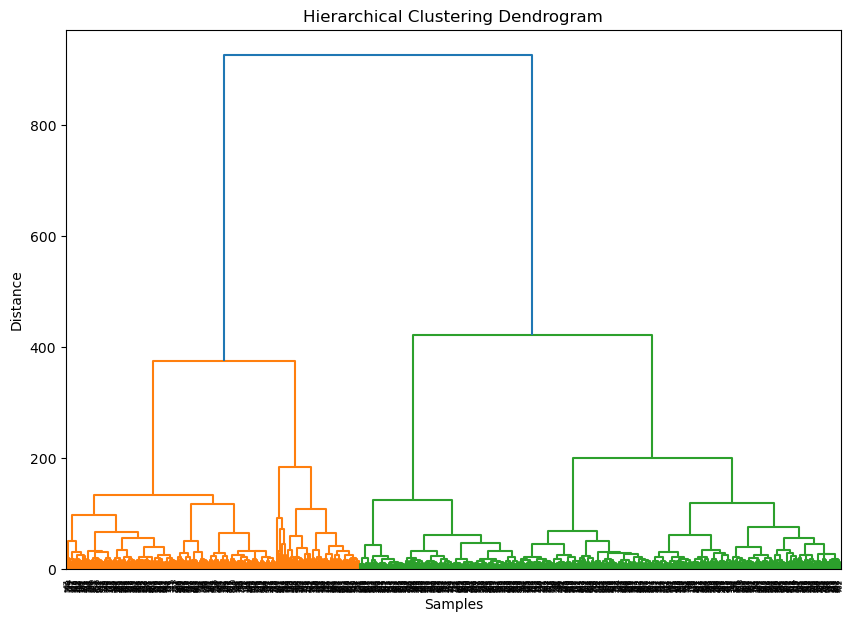

In [110]:
linkage_matrix_cbcl = linkage(cbcl_b_imp_knn, method='ward')  # You can use 'ward', 'single', 'complete', or 'average'

# Step 2: Plot the Dendrogram
plt.figure(figsize=(10, 7))
dendrogram(linkage_matrix_cbcl)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Samples')
plt.ylabel('Distance')
plt.show()

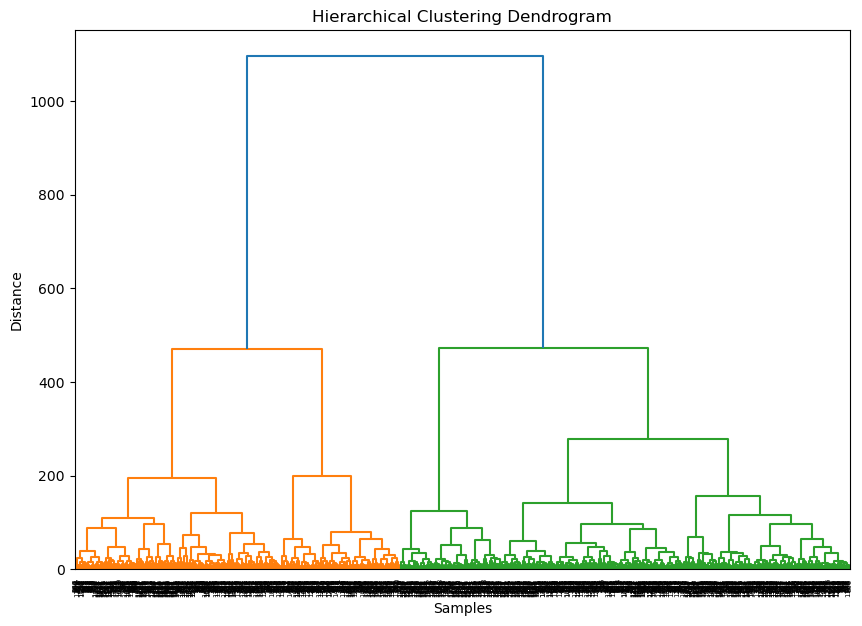

In [111]:
linkage_matrix_snap = linkage(snap_b_imp_knn, method='ward')  # You can use 'ward', 'single', 'complete', or 'average'

# Step 2: Plot the Dendrogram
plt.figure(figsize=(10, 7))
dendrogram(linkage_matrix_snap)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Samples')
plt.ylabel('Distance')
plt.show()

In [112]:
snap_b_imp_knn

,snap_adhd_1,snap_adhd_2,snap_adhd_3,snap_adhd_4,snap_adhd_5,snap_adhd_6,snap_adhd_7,snap_adhd_8,snap_adhd_9,snap_adhd_11,...,snainatt,snahypat,snaimput,snaaddwt,snaoddt,snatotlt,snahyimx,snaadhdt,snahit,snadbdx
0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,9.0,3.0,4.0,8.00,10.00,37.00,0.92,16.00,7.00,1.00
1,1.0,1.0,1.0,1.0,1.0,2.0,0.0,2.0,1.0,1.0,...,10.0,6.0,3.0,7.00,7.00,30.00,1.00,19.00,9.00,1.00
2,2.0,2.0,2.0,3.0,3.0,2.0,3.0,2.0,3.0,1.0,...,22.0,15.6,9.0,26.25,21.71,105.18,2.80,46.59,24.75,2.63
3,2.0,3.0,3.0,3.0,2.0,3.0,3.0,3.0,2.0,3.0,...,24.0,17.0,8.0,21.00,21.00,95.00,2.75,49.00,25.00,2.69
4,2.0,1.0,1.0,2.0,1.0,2.0,2.0,1.0,1.0,3.0,...,13.0,14.0,5.0,14.00,14.00,65.00,2.00,32.00,19.00,1.77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1459,3.0,3.0,3.0,3.0,3.0,3.0,2.0,3.0,2.0,3.0,...,25.0,16.0,8.0,21.00,13.00,86.00,2.67,49.00,24.00,2.38
1460,3.0,3.0,2.0,3.0,3.0,3.0,2.0,3.0,2.0,3.0,...,24.0,13.0,5.0,18.00,6.00,70.00,1.92,42.00,18.00,1.85
1461,2.0,2.0,2.0,3.0,1.0,3.0,0.0,3.0,0.0,3.0,...,16.0,14.0,9.0,10.00,23.00,80.00,2.67,39.00,23.00,2.38
1462,3.0,3.0,3.0,3.0,3.0,3.0,2.0,3.0,2.0,3.0,...,25.0,13.0,6.0,25.00,4.57,75.95,2.08,44.00,19.00,1.87


In [113]:
snap_cbcl_b_4clust = pd.concat((snap_b_imp_knn, cbcl_b_imp_knn), axis = 0)
snap_cbcl_b_4clust.shape

(2391, 206)

In [114]:
skrub.TableReport(snap_cbcl_b_4clust)

Processing column 206 / 206


<TableReport: use .open() to display>

In [115]:
linkage_matrix_snap_cbcl = linkage(snap_cbcl_b_4clust, method='ward')  # You can use 'ward', 'single', 'complete', or 'average'

# Step 2: Plot the Dendrogram
plt.figure(figsize=(10, 7))
dendrogram(linkage_matrix_snap_cbcl)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Samples')
plt.ylabel('Distance')
plt.show()

ValueError: The condensed distance matrix must contain only finite values.